In [1]:
%matplotlib inline

### We need some data first

In [2]:
from erddapy import ERDDAP


e = ERDDAP(server="https://data.ioos.us/gliders/erddap")

In [3]:
import pandas as pd


df = pd.read_csv(
    e.get_search_url(response="csv", search_for="all")
)

In [4]:
print(
    f"We have {len(set(df['tabledap'].dropna()))} "
    f"tabledap, {len(set(df['griddap'].dropna()))} "
    f"griddap, and {len(set(df['wms'].dropna()))} wms endpoints."
)

We have 547 tabledap, 0 griddap, and 0 wms endpoints.


In [5]:
kw = {
    "standard_name": "sea_water_temperature",
    "min_lon": -72.0,
    "max_lon": -69.0,
    "min_lat": 38.0,
    "max_lat": 41.0,
    "min_time": "2016-07-10T00:00:00Z",
    "max_time": "2017-02-10T00:00:00Z",
    "cdm_data_type": "trajectoryprofile"
}

In [6]:
df = pd.read_csv(
    e.get_search_url(response="csv", search_for="all", **kw)
)

In [7]:
print(
    f"We have {len(set(df['tabledap'].dropna()))} tabledap."
)

We have 16 tabledap.


In [8]:
search_url = e.get_search_url(response="csv", **kw)
search = pd.read_csv(search_url)
gliders = search["Dataset ID"].values

gliders_list = "\n".join(gliders)
print(f"Found {len(gliders)} Glider Datasets:\n{gliders_list}")

Found 16 Glider Datasets:
blue-20160818T1448
cp_335-20170116T1459
cp_336-20161011T0027
cp_336-20170116T1254
cp_340-20160809T0230
cp_374-20160529T0035
cp_374-20161011T0106
cp_376-20160527T2050
cp_379-20170116T1246
cp_380-20161011T2046
cp_387-20160404T1858
cp_388-20160809T1409
cp_389-20161011T2040
silbo-20160413T1534
sp022-20170209T1616
whoi_406-20160902T1700


In [9]:
variables = [
 "depth",
 "latitude",
 "longitude",
 "salinity",
 "temperature",
 "time",
]

constraints = {
    "longitude>=": kw["min_lon"],
    "longitude<=": kw["max_lon"],
    "latitude>=": kw["min_lat"],
    "latitude<=": kw["max_lat"],
    "time>=": kw["min_time"],
    "time<=": kw["max_time"],
}

In [10]:
def download_csv(url):
    return pd.read_csv(
        url,
        index_col="time",
        parse_dates=True,
        skiprows=[1],
    )

In [11]:
dataset_id = "whoi_406-20160902T1700"
e.dataset_id = dataset_id
e.protocol = "tabledap"
e.variables = variables
e.constraints = constraints

download_url = e.get_download_url(
    dataset_id=dataset_id,
    protocol="tabledap",
    variables=variables,
    response="csv",
    constraints=constraints
)

data = download_csv(download_url)

dfs = {dataset_id: data}

```python
from requests.exceptions import HTTPError


dfs = {}
for glider in gliders:
    try:
        download_url = e.get_download_url(
            dataset_id=glider,
            protocol="tabledap",
            variables=variables,
            response="csv",
            constraints=constraints
        )
        data = download_csv(download_url)
    except Exception:
        print(f"Failed to download {glider}.")
        continue
    dfs.update({glider: data})
```

### Altair

https://altair-viz.github.io

In [12]:
import altair
from vega_datasets import data


altair.renderers.enable("notebook")
print(altair.renderers.active)

notebook


In [13]:
df = dfs["whoi_406-20160902T1700"]


idxs = (df["depth"].diff() < 0).to_numpy().nonzero()[0]
first = idxs[0]
df["z"] = -df["depth"]

cast = df.iloc[:first]

In [14]:
altair.data_transformers.disable_max_rows()

altair.Chart(df).mark_point().encode(
    x="salinity",
    y="temperature",
)

In [15]:
altair.data_transformers.disable_max_rows()

altair.Chart(df).mark_point().encode(
    altair.X("salinity", scale=altair.Scale(domain=(25, 40))),
    y="temperature",
)

Exercise: fix the temperature scale too.

In [16]:
t = altair.Chart(cast).mark_line().encode(
    altair.Y("depth", sort="descending"),
    x="temperature",
)

s = altair.Chart(cast).mark_line().encode(
    altair.Y("depth", sort="descending"),
    x="salinity",
)

(t + t.mark_circle()) | (s + s.mark_circle()).interactive()

In [17]:
altair.Chart(df).mark_bar().encode(
    altair.X("depth:Q", bin=altair.BinParams(maxbins=20)),
    altair.Y("count()")
)

![](https://holoviz.org/assets/pn_hp_hv_gv_ds_pa_cs.png)

<https://pyviz.org/tools.html>

In [18]:
import geoviews as gv
import hvplot.pandas


xlim = df["longitude"].min()-0.25, df["longitude"].max()+0.25
ylim = df["latitude"].min()-0.25, df["latitude"].max()+0.25

gv.tile_sources.EsriOceanBase * df.hvplot.points(
    "longitude", "latitude",
    geo=True, color="organge", alpha=0.2, height=500,
    xlim=(-72, -70), ylim=(0, 72))

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [longitude,latitude]

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
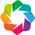

In [19]:
import geoviews as gv
import geoviews.feature as gf
from cartopy import crs

gv.extension("bokeh")

In [20]:
df.hvplot.scatter(
    x="salinity",
    y="temperature",
    alpha=0.25,
    datashade=True,
    rasterize=True,
    width=400,
    height=350,
)

:DynamicMap   []
   :RGB   [salinity,temperature]   (R,G,B,A)

In [21]:
cast.hvplot(
    x="temperature", y="z",
    width=350,
    height=400,
)

:Curve   [temperature]   (z)

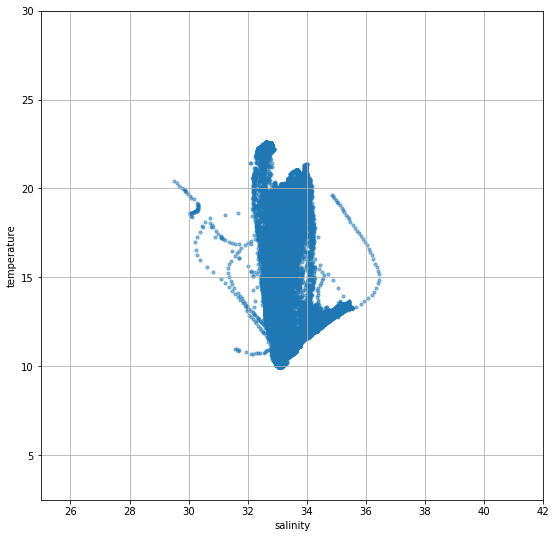

In [22]:
import matplotlib.pyplot as plt


def glider_scatter(df, ax, glider):
    ax.scatter(
        df["salinity"],
        df["temperature"],
        s=10, alpha=0.5, label=glider)

fig, ax = plt.subplots(figsize=(9, 9))
ax.set_xlabel("salinity")
ax.set_ylabel("temperature")
ax.grid(True)

for glider, df in dfs.items():
    glider_scatter(df, ax, glider)

ax.axis([25, 42, 2.5, 30]);

Exercise: this plot is really hard to explore. What would you do different?

### hvplot, geoviews, datashader via xarray

In [23]:
import xarray as xr


url = "http://thredds.secoora.org/thredds/dodsC/SECOORA_NCSU_CNAPS.nc"
ds = xr.open_dataset(url)
ds.info()

xarray.Dataset {
dimensions:
	eta_psi = 481 ;
	eta_rho = 482 ;
	eta_u = 482 ;
	eta_v = 481 ;
	s_rho = 36 ;
	s_w = 37 ;
	time = 7995 ;
	xi_psi = 401 ;
	xi_rho = 402 ;
	xi_u = 401 ;
	xi_v = 402 ;

variables:
	float64 Cs_r(s_rho) ;
		Cs_r:long_name = S-coordinate stretching curves at RHO-points ;
		Cs_r:valid_min = -1.0 ;
		Cs_r:valid_max = 0.0 ;
		Cs_r:field = Cs_r, scalar ;
		Cs_r:_ChunkSizes = 36 ;
	float64 Cs_w(s_w) ;
		Cs_w:long_name = S-coordinate stretching curves at W-points ;
		Cs_w:valid_min = -1.0 ;
		Cs_w:valid_max = 0.0 ;
		Cs_w:field = Cs_w, scalar ;
		Cs_w:_ChunkSizes = 37 ;
	float64 angle(eta_rho, xi_rho) ;
		angle:units = radians ;
		angle:long_name = angle between XI-axis and EAST ;
		angle:field = angle, scalar ;
		angle:_ChunkSizes = [482 402] ;
	float64 f(eta_rho, xi_rho) ;
		f:units = second-1 ;
		f:long_name = Coriolis parameter at RHO-points ;
		f:field = coriolis, scalar ;
		f:_ChunkSizes = [482 402] ;
	float64 h(eta_rho, xi_rho) ;
		h:time = time ;
		h:field = ba

Let's use only the surface temperature (-1 on ROMS models).

In [24]:
def size(array):
    nbytes = array.nbytes
    if nbytes < (1 << 10):
        size = f"{nbytes} B"
    elif nbytes < (1 << 20):
        size = f"{nbytes / (1 << 10):.02f} KiB"
    elif nbytes < (1 << 30):
        size = f"{nbytes / (1 << 20):.02f} MiB"
    elif nbytes < (1 << 40):
        size = f"{nbytes / (1 << 30):.02f} GiB"
    else:
        size = f"{nbytes / (1 << 40):.02f} TiB"
    return size

In [25]:
surface_temp = ds["temp"][:, -1, ...].squeeze()
size(surface_temp)

'5.77 GiB'

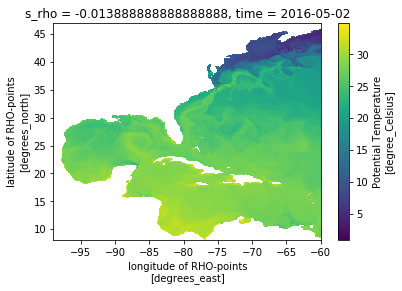

In [26]:
surface_temp[0, ...].plot(
    x="lon_rho",
    y="lat_rho",
);

In [27]:
import hvplot.xarray
import cartopy.crs as ccrs
import geoviews

In [28]:
surface_temp.hvplot.quadmesh(
    groupby="time",
    x="lon_rho",
    y="lat_rho",
    projection=ccrs.PlateCarree(),
    width=600, height=540,
    cmap="viridis",
    rasterize=True,
    dynamic=True,
) * geoviews.feature.land

:DynamicMap   [time]
   :Overlay
      .Image.I :Image   [lon_rho,lat_rho]   (temp)
      .Land.I  :Feature   [Longitude,Latitude]

Exercise: chose a [model from this](https://ioos.github.io/notebooks_demos/notebooks/2019-03-08-grids-temperature) notebook and reproduce the slice using `hvplot` and `xarray`. Warning, here be ~~dragons~~ sea monsters!

### Seaborn

In [29]:
import seaborn

kw = {
    "axes.edgecolor": "0",
    "text.color": "0",
    "ytick.color": "0",
    "xtick.color": "0",
    "ytick.major.size": 5,
    "xtick.major.size": 5,
    "axes.labelcolor": "0"
}

seaborn.set_style("whitegrid", kw)

In [30]:
df = pd.read_csv(
    "data/Corvinas_PBDE99.csv",
    na_values="NaN",
    index_col=False,
)

df.head()

,Days,ID,Recovery,Extract weight,Lipid %,Weight (g),Size (cm),Liver weight (g),LSI,CF,BDE 47 Liver,BDE 99 Liver
0,0,A,73.21,0.10,3.600000,20.09,12.8,0.14,0.696864,0.957966,0.0,0.0
1,0,B,98.24,0.22,2.272727,36.52,15.5,0.33,0.903614,0.980699,0.0,0.0
2,0,C,89.71,0.18,3.500000,28.74,14.7,0.25,0.869868,0.904763,0.0,0.0
3,1,A,78.40,0.13,1.330769,23.70,14.0,0.15,0.632911,0.863703,0.0,0.0
4,1,B,66.24,0.13,2.838462,32.80,15.0,0.20,0.609756,0.971852,0.0,0.0


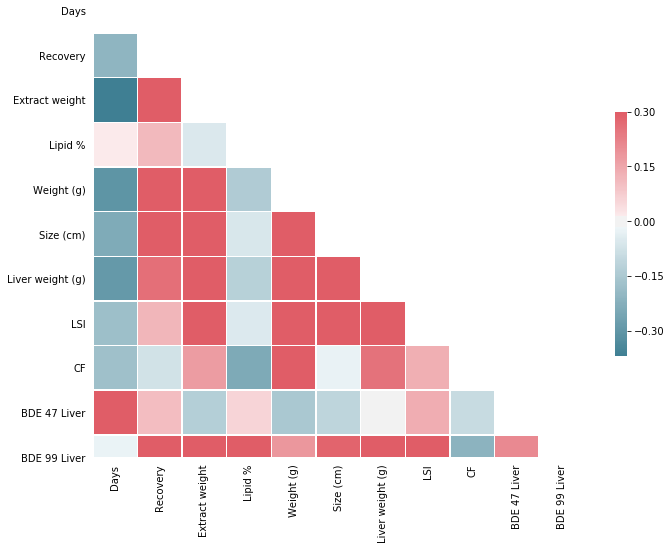

In [31]:
import numpy as np
import matplotlib.pyplot as plt


corr = df.corr()

mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

fig, ax = plt.subplots(figsize=(11, 9))

cmap = seaborn.diverging_palette(220, 10, as_cmap=True)
seaborn.heatmap(
    corr, mask=mask, cmap=cmap, vmax=.3, center=0,
    square=True, linewidths=.5, cbar_kws={"shrink": .5}
);

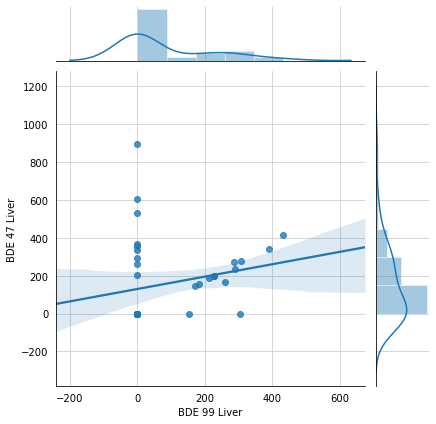

In [32]:
ax = seaborn.jointplot("BDE 99 Liver", "BDE 47 Liver", df, kind="reg")